In [ ]:
import argparse
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import warnings
import cv2
import time
import tensorflow as tf
import os
import pathlib
from toolz.curried import *

In [ ]:
from google.colab import drive
MOUNT_POINT = '/content/drive'
drive.mount(MOUNT_POINT, force_remount=True)
TENSORFLOW = os.path.join(MOUNT_POINT,'MyDrive','cse496','Tensorflow')
NOTEBOOK_WS = os.path.join(TENSORFLOW,'workspace','energy-meter-display')

Mounted at /content/drive


In [ ]:
MODEL_NAME = 'ssd_mobilenet_v2_320x320_coco17_tpu-8'

In [ ]:
paths = {
  'workspace': os.path.join(NOTEBOOK_WS),
  'images': os.path.join(NOTEBOOK_WS,'images'),
  'dataset': os.path.join(NOTEBOOK_WS,'dataset'),
  'labelmap': os.path.join(NOTEBOOK_WS,'annotations','label_map.pbtxt'),
  'models': os.path.join(TENSORFLOW,'models'),
  'annotations': os.path.join(NOTEBOOK_WS,'annotations'),
  'train_record': os.path.join(NOTEBOOK_WS,'annotations','train.record'),
  'test_record': os.path.join(NOTEBOOK_WS,'annotations','test.record'),
  'scripts': os.path.join(TENSORFLOW,'scripts'),
  'pre_trained_models': os.path.join(TENSORFLOW,'pre-trained-models'),
  'pre_trained_model': os.path.join(TENSORFLOW,'pre-trained-models',MODEL_NAME),
  'model': os.path.join(NOTEBOOK_WS,'models',MODEL_NAME),
  'pipeline': os.path.join(NOTEBOOK_WS,'models',MODEL_NAME,'pipeline.config'),
  'train_script': os.path.join(TENSORFLOW,'models','research','object_detection','model_main_tf2.py'),
  'export_script': os.path.join(TENSORFLOW,'models','research','object_detection','exporter_main_v2.py'),
  'infer_detections': os.path.join(TENSORFLOW,'models','research','object_detection','inference','infer_detections.py'),
  'exported_models': os.path.join(NOTEBOOK_WS,'exported_models'),
  'exported_model': os.path.join(NOTEBOOK_WS,'exported_models',MODEL_NAME),
}

In [ ]:
# TODO: don't run evaluation script requires higher version of pycocotools
#!pip install cython
#!pip install git+https://github.com/philferriere/cocoapi.git#subdirectory=PythonAPI

In [ ]:
%cd {paths['models']}/research
#!cp object_detection/packages/tf2/setup.py .
#!protoc object_detection/protos/*.proto --python_out=.
!python -m pip install .

/content/drive/MyDrive/cse496/Tensorflow/models/research
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/drive/MyDrive/cse496/Tensorflow/models/research
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
     |████████████████████████████████| 14.5 MB 70.4 MB/s 
     |████████████████████████████████| 352 kB 78.6 MB/s 
     |████████████████████████████████| 2.3 MB 62.1 MB/s 
     |████████████████████████████████| 26.9 MB 123 kB/s 
     |████████████████████████████████| 67 kB 8.2 MB/s 
     |████████████████████████████████| 116 kB 95.8 MB/s 
     |███████████████████████████

In [ ]:
from object_detection.utils import config_util, label_map_util 
from object_detection.utils import visualization_utils as viz_utils
from object_detection.protos import pipeline_pb2
from google.protobuf import text_format

In [ ]:
category_index = label_map_util.create_category_index_from_labelmap(paths['labelmap'], use_display_name=True)

# Split Dataset

In [ ]:
split_command = (f'''python {paths['scripts']}/partition_dataset.py \
   -i {paths['dataset']} \
   -o {paths['images']} \
   -r 0.1 \
   -x
   '''
)
split_command

'python /content/drive/MyDrive/cse496/Tensorflow/scripts/partition_dataset.py    -i /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/dataset    -o /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/images    -r 0.1    -x\n   '

In [ ]:
!{split_command}

/content/drive/MyDrive/cse496/Tensorflow/scripts/partition_dataset.py:35: DeprecationWarning: Flags not at the start of the expression '([a-zA-Z0-9\\s_\\\\.\\-\\' (truncated)
  if re.search(r'([a-zA-Z0-9\s_\\.\-\(\):])+(?i)(.jpg|.jpeg|.png)$', f)]


# Create TF Records

In [ ]:
generate_tf_record_train_command = 'python {} -x {} -l {} -o {}'.format(
  os.path.join(paths['scripts'], 'generate_tfrecord.py'),
  os.path.join(paths['images'], 'train'),
  os.path.join(paths['annotations'], 'label_map.pbtxt'),
  os.path.join(paths['annotations'], 'train.record'),
)
print(generate_tf_record_train_command)

python /content/drive/MyDrive/cse496/Tensorflow/scripts/generate_tfrecord.py -x /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/images/train -l /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/annotations/label_map.pbtxt -o /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/annotations/train.record


In [ ]:
!{generate_tf_record_train_command}

Successfully created the TFRecord file: /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/annotations/train.record


In [ ]:
generate_tf_record_test_command = 'python {} -x {} -l {} -o {}'.format(
  os.path.join(paths['scripts'], 'generate_tfrecord.py'),
  os.path.join(paths['images'], 'test'),
  os.path.join(paths['annotations'], 'label_map.pbtxt'),
  os.path.join(paths['annotations'], 'test.record'),
)
print(generate_tf_record_test_command)

python /content/drive/MyDrive/cse496/Tensorflow/scripts/generate_tfrecord.py -x /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/images/test -l /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/annotations/label_map.pbtxt -o /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/annotations/test.record


In [ ]:
!{generate_tf_record_test_command}

Successfully created the TFRecord file: /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/annotations/test.record


In [ ]:
#!python object_detection/builders/model_builder_tf2_test.py


# Training Pipeline

In [ ]:
!mkdir -p {paths['model']}

shell-init: error retrieving current directory: getcwd: cannot access parent directories: Transport endpoint is not connected


In [ ]:
copy_pre_trained_model_command = 'cp {} {}'.format(
  os.path.join(paths['pre_trained_model'],'pipeline.config'),
  paths['model'],
) 
copy_pre_trained_model_command 

'cp /content/drive/MyDrive/cse496/Tensorflow/pre-trained-models/ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/models/ssd_mobilenet_v2_320x320_coco17_tpu-8'

In [ ]:
!{copy_pre_trained_model_command}

shell-init: error retrieving current directory: getcwd: cannot access parent directories: Transport endpoint is not connected


In [ ]:
config = config_util.get_configs_from_pipeline_file(paths['pipeline'])

config

{'model': ssd {
   num_classes: 10
   image_resizer {
     fixed_shape_resizer {
       height: 300
       width: 300
     }
   }
   feature_extractor {
     type: "ssd_mobilenet_v2_keras"
     depth_multiplier: 1.0
     min_depth: 16
     conv_hyperparams {
       regularizer {
         l2_regularizer {
           weight: 3.9999998989515007e-05
         }
       }
       initializer {
         truncated_normal_initializer {
           mean: 0.0
           stddev: 0.029999999329447746
         }
       }
       activation: RELU_6
       batch_norm {
         decay: 0.9700000286102295
         center: true
         scale: true
         epsilon: 0.0010000000474974513
         train: true
       }
     }
     override_base_feature_extractor_hyperparams: true
   }
   box_coder {
     faster_rcnn_box_coder {
       y_scale: 10.0
       x_scale: 10.0
       height_scale: 5.0
       width_scale: 5.0
     }
   }
   matcher {
     argmax_matcher {
       matched_threshold: 0.5
       unmatched_

In [ ]:
pipeline_config = pipeline_pb2.TrainEvalPipelineConfig()
with tf.io.gfile.GFile(paths['pipeline'], "r") as f:                                                                                                                                                                                                                     
    proto_str = f.read()                                                                                                                                                                                                                                          
    text_format.Merge(proto_str, pipeline_config)

In [ ]:
pipeline_config.model.ssd.num_classes = len(category_index)
#pipeline_config.model.ssd.loss.localization_weight = 0.8
#pipeline_config.model.ssd.loss.classification_weight = 1.3
pipeline_config.train_config.batch_size = 32
pipeline_config.train_config.fine_tune_checkpoint = os.path.join(paths['pre_trained_model'],'checkpoint','ckpt-0')
pipeline_config.train_config.fine_tune_checkpoint_type = 'detection'
pipeline_config.train_input_reader.label_map_path= paths['labelmap']
pipeline_config.train_input_reader.tf_record_input_reader.input_path[:] = [paths['train_record']]
pipeline_config.eval_input_reader[0].label_map_path = paths['labelmap']
pipeline_config.eval_input_reader[0].tf_record_input_reader.input_path[:] = [paths['test_record']]

In [ ]:

pipeline_config.train_config.data_augmentation_options.pop()

In [ ]:
pipeline_config

model {
  ssd {
    num_classes: 10
    image_resizer {
      fixed_shape_resizer {
        height: 300
        width: 300
      }
    }
    feature_extractor {
      type: "ssd_mobilenet_v2_keras"
      depth_multiplier: 1.0
      min_depth: 16
      conv_hyperparams {
        regularizer {
          l2_regularizer {
            weight: 3.9999998989515007e-05
          }
        }
        initializer {
          truncated_normal_initializer {
            mean: 0.0
            stddev: 0.029999999329447746
          }
        }
        activation: RELU_6
        batch_norm {
          decay: 0.9700000286102295
          center: true
          scale: true
          epsilon: 0.0010000000474974513
          train: true
        }
      }
      override_base_feature_extractor_hyperparams: true
    }
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
   

In [ ]:
config_text = text_format.MessageToString(pipeline_config)                                                                                                                                                                                                        
with tf.io.gfile.GFile(paths['pipeline'], "wb") as f:                                                                                                                                                                                                                     
    f.write(config_text)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir={os.path.join(paths['workspace'],'models')}

<IPython.core.display.Javascript object>

In [ ]:
num_train_steps=50000
train_command = 'python {} --model_dir={} --pipeline_config_path={} --num_train_steps {}'.format(
    paths['train_script'], paths['model'], paths['pipeline'], num_train_steps
)

print(train_command)

python /content/drive/MyDrive/cse496/Tensorflow/models/research/object_detection/model_main_tf2.py --model_dir=/content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/models/ssd_mobilenet_v2_320x320_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/models/ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config --num_train_steps 50000


In [ ]:
!{train_command}

2022-12-05 06:23:31.212515: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.8/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2022-12-05 06:23:31.212729: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.8/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2022-12-05 06:23:31.212750: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
/usr/local/lib/python3.8/dist-packages/tensorflow_addons/

In [ ]:
# Evaluation During Training: run parallel to training
eval_command = 'python {} --model_dir={} --pipeline_config_path={} --checkpoint_dir={}'.format(
    paths['train_script'],
    paths['model'],
    paths['pipeline'],
    paths['model']
)
print(eval_command)

In [ ]:
!{eval_command}

In [ ]:
!mkdir -p {paths['exported_model']}
export_command = 'python {} --input_type image_tensor --pipeline_config_path {} --trained_checkpoint_dir {} --output_directory {}'.format(
    paths['export_script'],
    paths['pipeline'],
    paths['model'],
    paths['exported_model']
)

print(export_command)

python /content/drive/MyDrive/cse496/Tensorflow/models/research/object_detection/exporter_main_v2.py --input_type image_tensor --pipeline_config_path /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/models/ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config --trained_checkpoint_dir /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/models/ssd_mobilenet_v2_320x320_coco17_tpu-8 --output_directory /content/drive/MyDrive/cse496/Tensorflow/workspace/energy-meter-display/exported_models/ssd_mobilenet_v2_320x320_coco17_tpu-8


In [ ]:
!{export_command}


2022-12-05 06:51:52.949907: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.8/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2022-12-05 06:51:52.950012: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.8/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2022-12-05 06:51:52.950029: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
/usr/local/lib/python3.8/dist-packages/tensorflow_addons/

# Test

In [ ]:
detect_fn = tf.saved_model.load(os.path.join(paths['exported_model'],'saved_model'))

In [ ]:
def upload_files():
  from google.colab import files
  uploaded = files.upload()
  for k, v in uploaded.items():
    open(k, 'wb').write(v)
  return list(uploaded.keys())

def load_image_into_numpy_array(path):
  return pipe(
      path,
      Image.open,
      lambda x: x.convert('RGB'),
      np.array
  )

def detect(image_path):
  return pipe(
      image_path,
      load_image_into_numpy_array,
      lambda im: pipe(
        im,
        tf.convert_to_tensor,
        lambda x: x[tf.newaxis, ...],
        detect_fn,
        lambda detections: merge(detections, {'image': im})
      )
  )


In [ ]:
imgs = upload_files()
print(imgs)

Saving Meter-Reading-kWh-01-893x1024.jpg to Meter-Reading-kWh-01-893x1024.jpg
['Meter-Reading-kWh-01-893x1024.jpg']


env: DPI=300


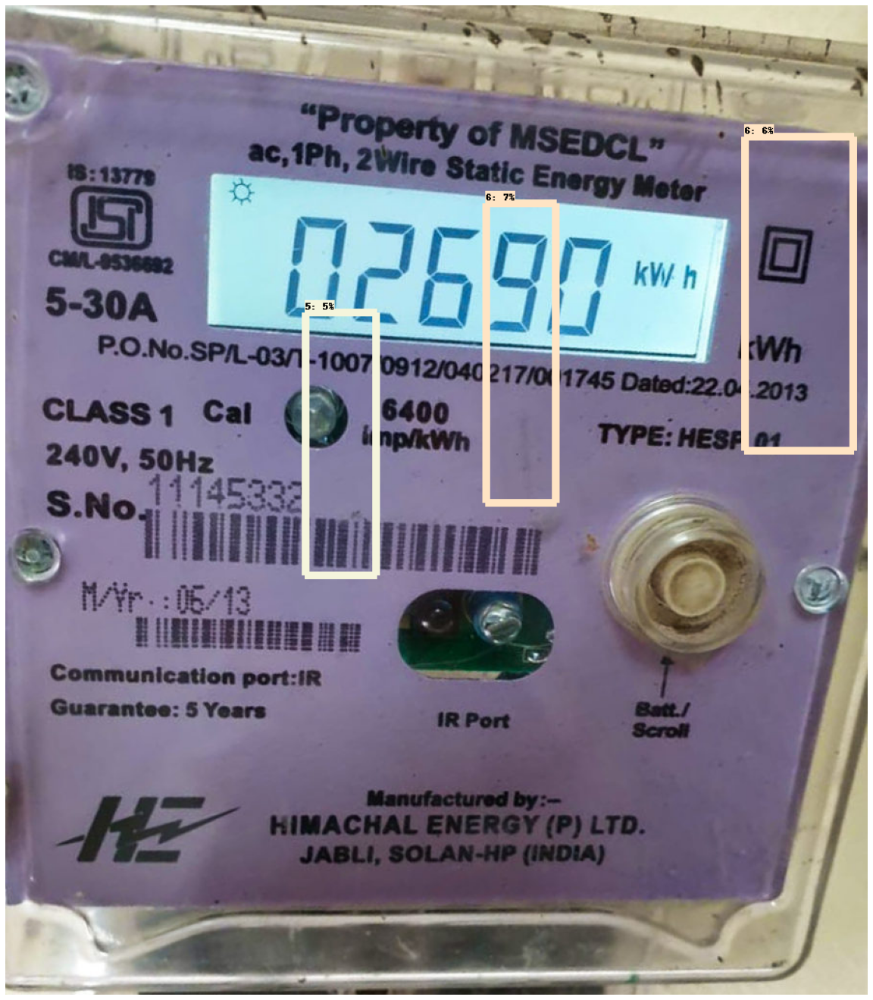

[]


In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
# import warnings
# warnings.filterwarnings('ignore')
from object_detection.utils import visualization_utils as viz_utils

%env DPI=300

for image_path in imgs:
  detections = detect(image_path)
  viz_utils.visualize_boxes_and_labels_on_image_array(
          detections['image'],
          detections['detection_boxes'][0].numpy(),
          (detections['detection_classes'][0].numpy()).astype(int),
          detections['detection_scores'][0].numpy(),
          category_index,
          use_normalized_coordinates=True,
          max_boxes_to_draw=100,     
          min_score_thresh=.04,      
          line_thickness=8,
          #skip_scores=True,
          agnostic_mode=False
  )
  %matplotlib inline
  plt.figure(figsize = (24,24))
  plt.imshow(detections['image'])
  plt.axis('off')
  plt.show()
  print ([ int(value) for index,value in enumerate(detections['detection_classes'][0]) if detections['detection_scores'][0][index] > 0.5])